# Godaddy forecasting with the Temporal Fusion Transformer

In [2]:
!pip install pytorch_forecasting

In [3]:
import copy
from pathlib import Path
import warnings

import numpy as np
import pandas as pd
import pytorch_lightning as pl
from pytorch_lightning.callbacks import EarlyStopping, LearningRateMonitor
from pytorch_lightning.loggers import TensorBoardLogger
import torch

from pytorch_forecasting import Baseline, TemporalFusionTransformer, TimeSeriesDataSet
from pytorch_forecasting.data import GroupNormalizer
from pytorch_forecasting.metrics import SMAPE, PoissonLoss, QuantileLoss
from pytorch_forecasting.models.temporal_fusion_transformer.tuning import optimize_hyperparameters

/opt/conda/lib/python3.7/site-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (SMAPE). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_full_state_property`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)


In [4]:
torch.cuda.is_available()

True

## Load data

In [5]:
data = pd.read_csv('../input/godaddy-microbusiness-density-forecasting/train.csv')

In [6]:
data

,row_id,cfips,county,state,first_day_of_month,microbusiness_density,active
0,1001_2019-08-01,1001,Autauga County,Alabama,2019-08-01,3.007682,1249
1,1001_2019-09-01,1001,Autauga County,Alabama,2019-09-01,2.884870,1198
2,1001_2019-10-01,1001,Autauga County,Alabama,2019-10-01,3.055843,1269
3,1001_2019-11-01,1001,Autauga County,Alabama,2019-11-01,2.993233,1243
4,1001_2019-12-01,1001,Autauga County,Alabama,2019-12-01,2.993233,1243
...,...,...,...,...,...,...,...
122260,56045_2022-06-01,56045,Weston County,Wyoming,2022-06-01,1.803249,101
122261,56045_2022-07-01,56045,Weston County,Wyoming,2022-07-01,1.803249,101
122262,56045_2022-08-01,56045,Weston County,Wyoming,2022-08-01,1.785395,100
122263,56045_2022-09-01,56045,Weston County,Wyoming,2022-09-01,1.785395,100


In [7]:
# We need a time index, so a function to apply on each row
def strip(row):
    indy = (int(row["first_day_of_month"].split('-')[0]) * 12 +  int(row["first_day_of_month"].split('-')[1]))
    return indy

In [8]:
data['time_idx'] = data.apply(strip, axis=1)

In [9]:
start = data["time_idx"].min()
print(start)

24236


In [10]:
data['time_idx'] -= start

In [11]:
data

,row_id,cfips,county,state,first_day_of_month,microbusiness_density,active,time_idx
0,1001_2019-08-01,1001,Autauga County,Alabama,2019-08-01,3.007682,1249,0
1,1001_2019-09-01,1001,Autauga County,Alabama,2019-09-01,2.884870,1198,1
2,1001_2019-10-01,1001,Autauga County,Alabama,2019-10-01,3.055843,1269,2
3,1001_2019-11-01,1001,Autauga County,Alabama,2019-11-01,2.993233,1243,3
4,1001_2019-12-01,1001,Autauga County,Alabama,2019-12-01,2.993233,1243,4
...,...,...,...,...,...,...,...,...
122260,56045_2022-06-01,56045,Weston County,Wyoming,2022-06-01,1.803249,101,34
122261,56045_2022-07-01,56045,Weston County,Wyoming,2022-07-01,1.803249,101,35
122262,56045_2022-08-01,56045,Weston County,Wyoming,2022-08-01,1.785395,100,36
122263,56045_2022-09-01,56045,Weston County,Wyoming,2022-09-01,1.785395,100,37


In [12]:
# let's add some additional features; due to sesonal effects month should be top priority
def month(row):
    mon = int(row['first_day_of_month'].split('-')[1])
    return mon

In [13]:
# add additional features
data["month"] = data.apply(month, axis=1)
data["log_active"] = np.log(data.active + 1e-8)
# We will treat the average per county as a known constant
data["log_active_by_cfips"] = data.groupby(["cfips"], observed=True).log_active.transform("mean")

In [14]:
data.head()

,row_id,cfips,county,state,first_day_of_month,microbusiness_density,active,time_idx,month,log_active,log_active_by_cfips
0,1001_2019-08-01,1001,Autauga County,Alabama,2019-08-01,3.007682,1249,0,8,7.130099,7.192549
1,1001_2019-09-01,1001,Autauga County,Alabama,2019-09-01,2.884870,1198,1,9,7.088409,7.192549
2,1001_2019-10-01,1001,Autauga County,Alabama,2019-10-01,3.055843,1269,2,10,7.145984,7.192549
3,1001_2019-11-01,1001,Autauga County,Alabama,2019-11-01,2.993233,1243,3,11,7.125283,7.192549
4,1001_2019-12-01,1001,Autauga County,Alabama,2019-12-01,2.993233,1243,4,12,7.125283,7.192549


In [15]:
data.describe()

,cfips,microbusiness_density,active,time_idx,month,log_active,log_active_by_cfips
count,122265.000000,122265.000000,1.222650e+05,122265.000000,122265.000000,122265.000000,122265.000000
mean,30376.037640,3.817671,6.442858e+03,19.000000,6.692308,6.419539,6.419539
std,15143.508721,4.991087,3.304001e+04,11.254675,3.390452,2.044134,2.030544
min,1001.000000,0.000000,0.000000e+00,0.000000,1.000000,-18.420681,-9.741098
25%,18177.000000,1.639344,1.450000e+02,9.000000,4.000000,4.976734,4.973504
50%,29173.000000,2.586543,4.880000e+02,19.000000,7.000000,6.190315,6.196564
75%,45077.000000,4.519231,2.124000e+03,29.000000,10.000000,7.661056,7.651782
max,56045.000000,284.340030,1.167744e+06,38.000000,12.000000,13.970584,13.932371


### Create dataset and dataloaders

In [18]:
max_prediction_length = 3
max_encoder_length = 24
training_cutoff = data["time_idx"].max() - max_prediction_length

training = TimeSeriesDataSet(
    data[lambda x: x.time_idx <= training_cutoff],
    time_idx="time_idx",
    target="microbusiness_density",
    group_ids=["cfips"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=['state'],
    static_reals=['log_active_by_cfips'],
    time_varying_known_categoricals=[],
    variable_groups={},  # group of categorical variables can be treated as one variable
    time_varying_known_reals=["time_idx", "month"],
    time_varying_unknown_categoricals=[],
    time_varying_unknown_reals=["microbusiness_density"],

    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

# create validation set (predict=True) which means to predict the last max_prediction_length points in time
# for each series
validation = TimeSeriesDataSet.from_dataset(training, data, predict=True, stop_randomization=True)

# create dataloaders for model
batch_size = 128  # set this between 32 to 128
train_dataloader = training.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader = validation.to_dataloader(train=False, batch_size=batch_size * 10, num_workers=0)

## Create baseline model

In [19]:
# calculate baseline mean absolute error, i.e. predict next value as the last available value from the history
# actuals = torch.cat([y for x, (y, weight) in iter(val_dataloader)])# 
# baseline_predictions = Baseline().predict(val_dataloader)
# (actuals - baseline_predictions).abs().mean().item()

## Train the Temporal Fusion Transformer

### Find optimal learning rate

Prior to training, you can identify the optimal learning rate with the [PyTorch Lightning learning rate finder](https://pytorch-lightning.readthedocs.io/en/latest/lr_finder.html).

In [20]:
# configure network and trainer
pl.seed_everything(42)
trainer = pl.Trainer(
    gpus=1,
    # clipping gradients is a hyperparameter and important to prevent divergance
    # of the gradient for recurrent neural networks
    gradient_clip_val=0.1,
)


tft = TemporalFusionTransformer.from_dataset(
    training,
    # not meaningful for finding the learning rate but otherwise very important
    learning_rate=0.03,
    hidden_size=16,  # most important hyperparameter apart from learning rate
    # number of attention heads. Set to up to 4 for large datasets
    attention_head_size=1,
    dropout=0.1,  # between 0.1 and 0.3 are good values
    hidden_continuous_size=8,  # set to <= hidden_size
    output_size=7,  # 7 quantiles by default
    loss=QuantileLoss(),
    # reduce learning rate if no improvement in validation loss after x epochs
    reduce_on_plateau_patience=4,
)
print(f"Number of parameters in network: {tft.size()/1e3:.1f}k")

/opt/conda/lib/python3.7/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:448: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  f"Setting `Trainer(gpus={gpus!r})` is deprecated in v1.7 and will be removed"


Number of parameters in network: 21.6k


/opt/conda/lib/python3.7/site-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (QuantileLoss). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_full_state_property`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property calle

In [ ]:
# find optimal learning rate
res = trainer.tuner.lr_find(
    tft,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
    max_lr=10.0,
    min_lr=1e-6,
)

print(f"suggested learning rate: {res.suggestion()}")
fig = res.plot(show=True, suggest=True)
fig.show()

/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid feature names, but"
/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid feature names, but"
/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid feature names, but"
/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid feature names, but"
/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid 

Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid feature names, but"
/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid feature names, but"
/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid feature names, but"
/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid feature names, but"
/opt/conda/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  "X does not have valid 

### Train model

If you have troubles training the model and get an error ```AttributeError: module 'tensorflow._api.v2.io.gfile' has no attribute 'get_filesystem'```, consider either uninstalling tensorflow or first execute

```
import tensorflow as tf
import tensorboard as tb
tf.io.gfile = tb.compat.tensorflow_stub.io.gfile
```.

In [32]:
import tensorflow as tf
import tensorboard as tb
tf.io.gfile = tb.compat.tensorflow_stub.io.gfile

In [33]:
# configure network and trainer
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
lr_logger = LearningRateMonitor()  # log the learning rate
logger = TensorBoardLogger("lightning_logs")  # logging results to a tensorboard

trainer = pl.Trainer(
    max_epochs=8,
    gpus=0,
    weights_summary="top",
    gradient_clip_val=0.1,
    limit_train_batches=30,  # coment in for training, running valiation every 30 batches
    # fast_dev_run=True,  # comment in to check that networkor dataset has no serious bugs
    callbacks=[lr_logger, early_stop_callback],
    logger=logger,
)


tft = TemporalFusionTransformer.from_dataset(
    training,
    learning_rate=0.01,
    hidden_size=16,
    attention_head_size=1,
    dropout=0.1,
    hidden_continuous_size=8,
    output_size=7,  # 7 quantiles by default
    loss=QuantileLoss(),
    log_interval=10,  # uncomment for learning rate finder and otherwise, e.g. to 10 for logging every 10 batches
    reduce_on_plateau_patience=4,
)
print(f"Number of parameters in network: {tft.size()/1e3:.1f}k")

GPU available: True, used: False

TPU available: False, using: 0 TPU cores

IPU available: False, using: 0 IPUs

HPU available: False, using: 0 HPUs


Number of parameters in network: 21.6k


/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/pytorch_lightning/trainer/trainer.py:1826: PossibleUserWarning: GPU available but not used. Set `accelerator` and `devices` using `Trainer(accelerator='gpu', devices=1)`.

  category=PossibleUserWarning,

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/pytorch_lightning/utilities/parsing.py:245: UserWarning: Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.

  f"Attribute {k!r} is an instance of `nn.Module` and is already saved during checkpointing."

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/pytorch_lightning/utilities/parsing.py:245: UserWarning: Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.

  f"Attribute {k!r} is an instance 

Training takes a couple of minutes on my Macbook but for larger networks and datasets, it can take hours. The training speed is here mostly determined by overhead and choosing a larger `batch_size` or `hidden_size` (i.e. network size) does not slow does training linearly making training on large datasets feasible. During training, we can monitor the tensorboard which can be spun up with `tensorboard --logdir=lightning_logs`. For example, we can monitor examples predictions on the training and validation set.

In [34]:
# fit network
trainer.fit(
    tft,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

Missing logger folder: lightning_logs/lightning_logs



   | Name                               | Type                            | Params

----------------------------------------------------------------------------------------

0  | loss                               | QuantileLoss                    | 0     

1  | logging_metrics                    | ModuleList                      | 0     

2  | input_embeddings                   | MultiEmbedding                  | 714   

3  | prescalers                         | ModuleDict                      | 128   

4  | static_variable_selection          | VariableSelectionNetwork        | 2.5 K 

5  | encoder_variable_selection         | VariableSelectionNetwork        | 2.4 K 

6  | decoder_variable_selection         | VariableSelectionNetwork        | 1.8 K 

7  | static_context_variable_selection  | GatedResidualNetwork            | 1.1 K 

8  | static_context_initial_hidden_lstm | GatedResidualNetwork            | 1.1 K 

9  | static_co

Sanity Checking: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:245: PossibleUserWarning: The dataloader, val_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 12 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.

  category=PossibleUserWarning,

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature 

Training: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

Validation: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

Validation: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

Validation: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

Validation: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

Validation: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

Validation: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

Validation: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

Validation: 0it [00:00, ?it/s]

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

### Hyperparameter tuning

## Evaluate performance

PyTorch Lightning automatically checkpoints training and thus, we can easily retrieve the best model and load it.

In [35]:
# load the best model according to the validation loss
# (given that we use early stopping, this is not necessarily the last epoch)
best_model_path = trainer.checkpoint_callback.best_model_path
best_tft = TemporalFusionTransformer.load_from_checkpoint(best_model_path)

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/pytorch_lightning/utilities/parsing.py:245: UserWarning: Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.

  f"Attribute {k!r} is an instance of `nn.Module` and is already saved during checkpointing."

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/pytorch_lightning/utilities/parsing.py:245: UserWarning: Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.

  f"Attribute {k!r} is an instance of `nn.Module` and is already saved during checkpointing."


In [36]:
# calcualte mean absolute error on validation set
actuals = torch.cat([y[0] for x, y in iter(val_dataloader)])
predictions = best_tft.predict(val_dataloader)
(actuals - predictions).abs().mean()

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

tensor(0.2003)

In [37]:
# raw predictions are a dictionary from which all kind of information including quantiles can be extracted
raw_predictions, x = best_tft.predict(val_dataloader, mode="raw", return_x=True)

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

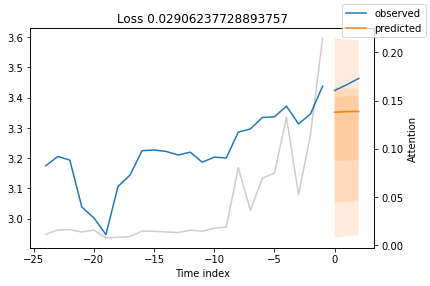

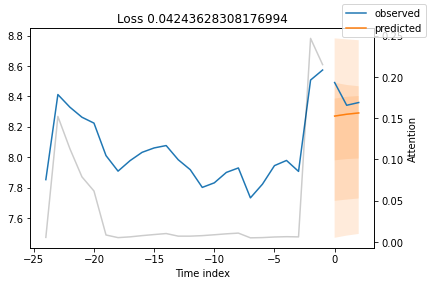

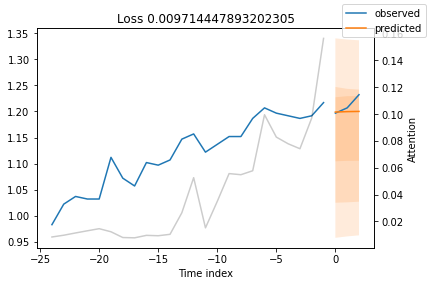

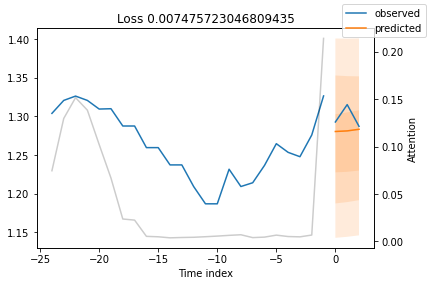

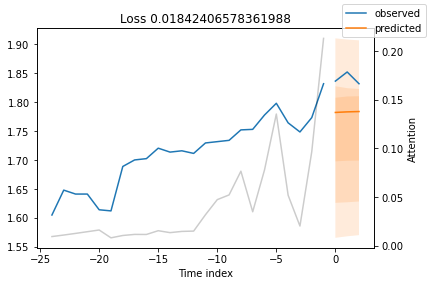

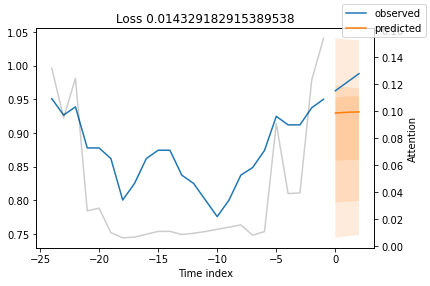

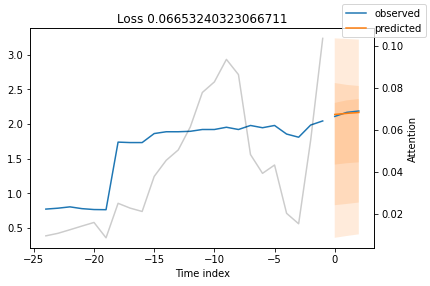

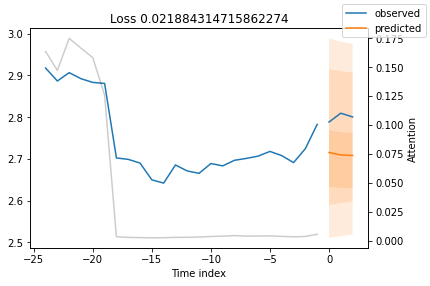

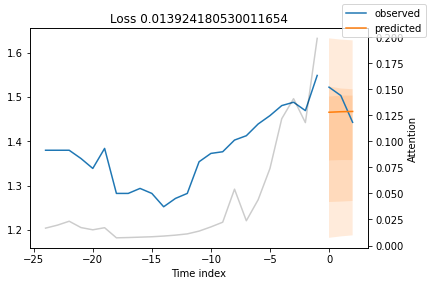

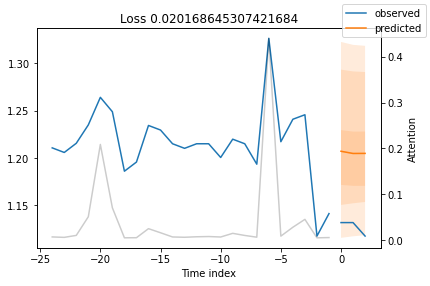

In [38]:
for idx in range(10):  # plot 10 examples
    best_tft.plot_prediction(x, raw_predictions, idx=idx, add_loss_to_title=True);

### Worst performers

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

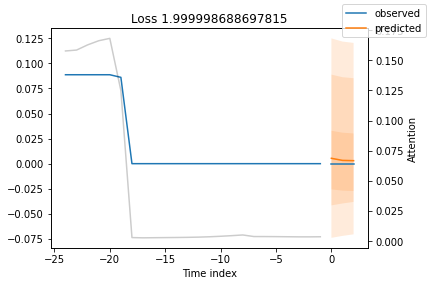

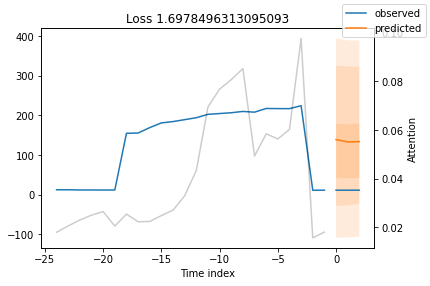

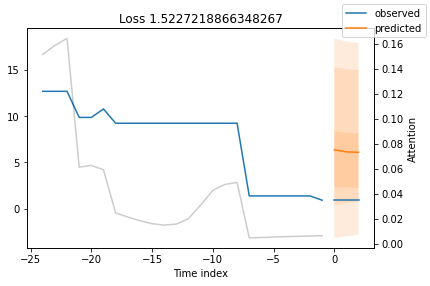

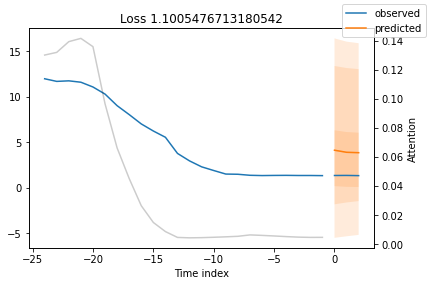

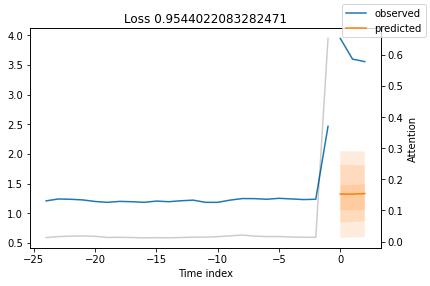

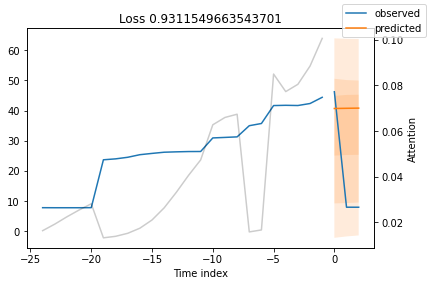

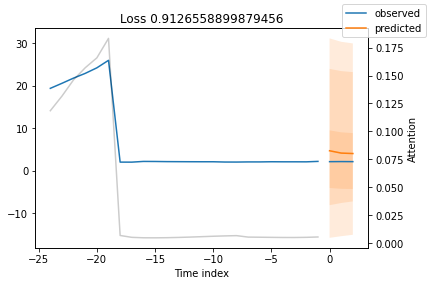

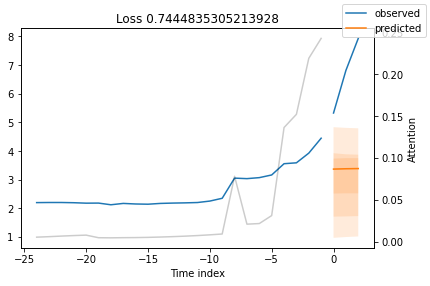

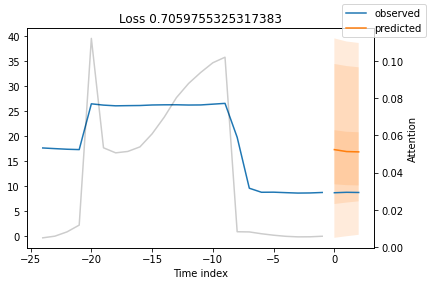

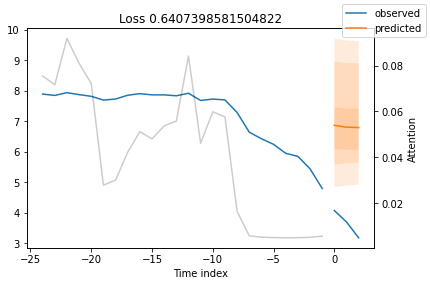

In [39]:
# calcualte metric by which to display
predictions = best_tft.predict(val_dataloader)
mean_losses = SMAPE(reduction="none")(predictions, actuals).mean(1)
indices = mean_losses.argsort(descending=True)  # sort losses
for idx in range(10):  # plot 10 examples
    best_tft.plot_prediction(
        x, raw_predictions, idx=indices[idx], add_loss_to_title=SMAPE(quantiles=best_tft.loss.quantiles)
    );

### Actuals vs predictions by variables

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names

  "X does not have valid feature names, but"

/home/lacsi/anaconda3/envs/tft/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning: X d

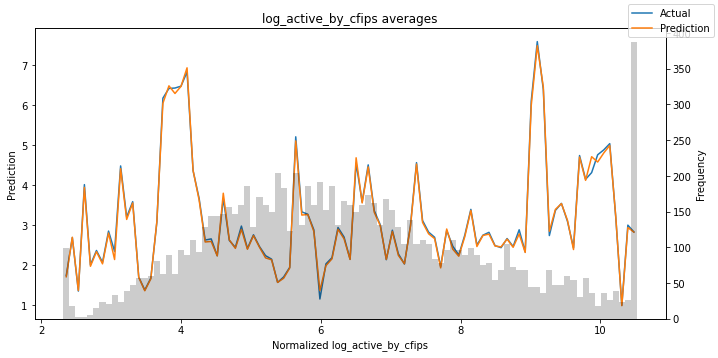

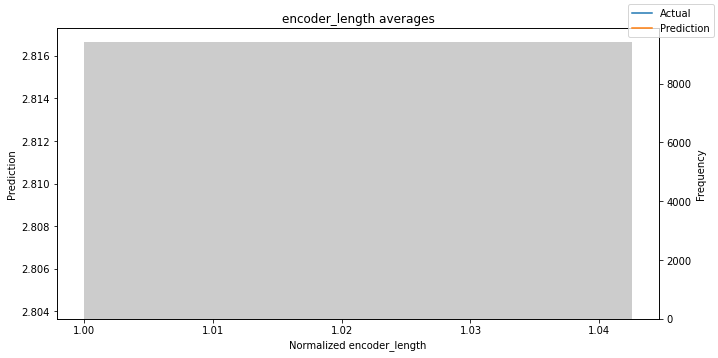

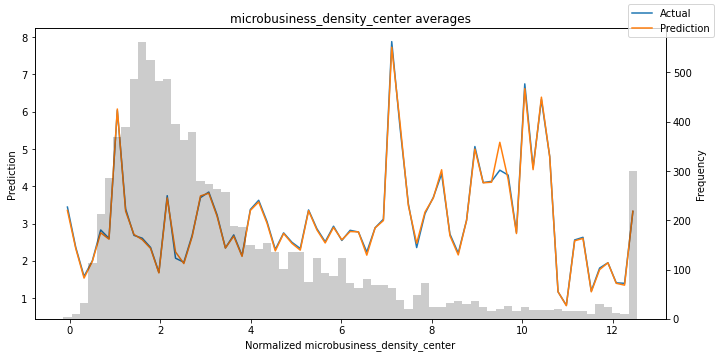

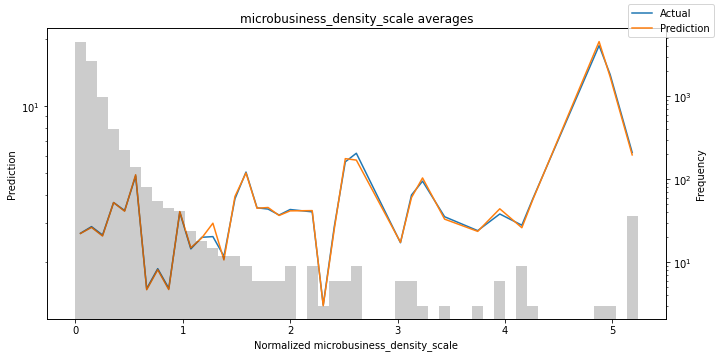

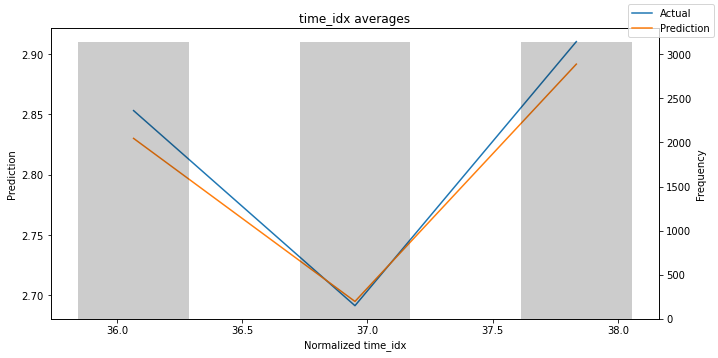

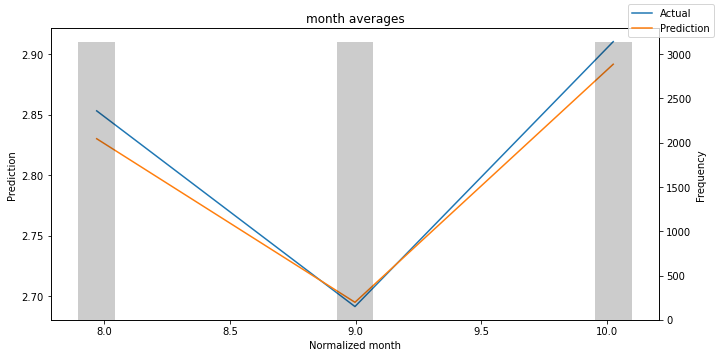

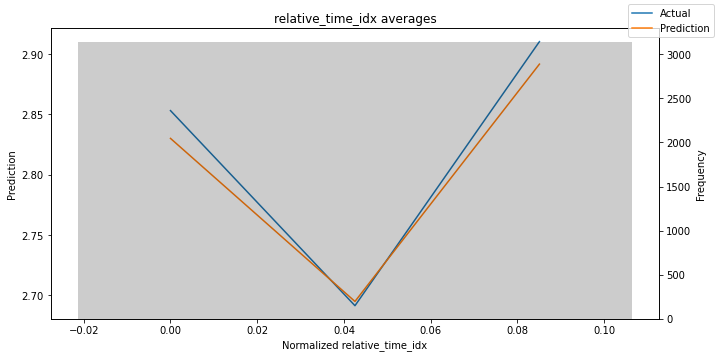

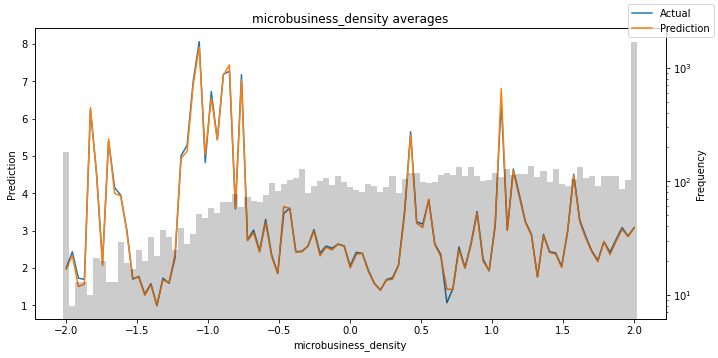

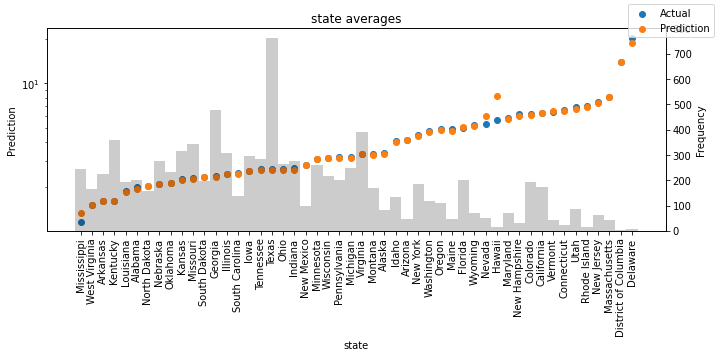

In [40]:
predictions, x = best_tft.predict(val_dataloader, return_x=True)
predictions_vs_actuals = best_tft.calculate_prediction_actual_by_variable(x, predictions)
best_tft.plot_prediction_actual_by_variable(predictions_vs_actuals);

## Predict on selected data

In [18]:
best_tft.predict(
    training.filter(lambda x: (x.agency == "Agency_01") & (x.sku == "SKU_01") & (x.time_idx_first_prediction == 15)),
    mode="quantiles",
)

tensor([[[ 34.8978,  49.2634,  72.2666,  85.7628, 110.5854, 131.6044, 178.4841],
         [ 44.5931,  52.8931,  76.6638,  89.4482, 108.6307, 127.5157, 178.6292],
         [ 53.6447,  61.0609,  83.4454,  91.7652, 108.4944, 125.5182, 174.2801],
         [ 49.4695,  56.7736,  79.6696,  88.4478, 104.5506, 124.9454, 173.7973],
         [ 35.9173,  42.8673,  70.5397,  85.4087, 109.5104, 132.1529, 177.8164],
         [ 38.8819,  48.8986,  69.3231,  78.0562,  96.4577, 122.2134, 168.6871]]])

Of course, we can also plot this prediction readily:

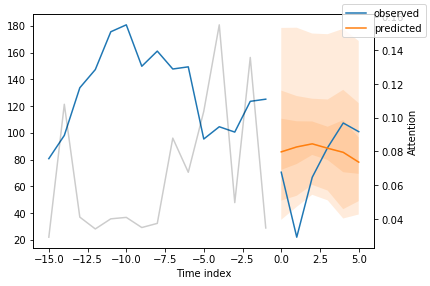

In [19]:
raw_prediction, x = best_tft.predict(
    training.filter(lambda x: (x.agency == "Agency_01") & (x.sku == "SKU_01") & (x.time_idx_first_prediction == 15)),
    mode="raw",
    return_x=True,
)
best_tft.plot_prediction(x, raw_prediction, idx=0);

## Predict on new data

Because we have covariates in the dataset, predicting on new data requires us to define the known covariates upfront.

In [20]:
# select last 24 months from data (max_encoder_length is 24)
encoder_data = data[lambda x: x.time_idx > x.time_idx.max() - max_encoder_length]

# select last known data point and create decoder data from it by repeating it and incrementing the month
# in a real world dataset, we should not just forward fill the covariates but specify them to account
# for changes in special days and prices (which you absolutely should do but we are too lazy here)
last_data = data[lambda x: x.time_idx == x.time_idx.max()]
decoder_data = pd.concat(
    [last_data.assign(date=lambda x: x.date + pd.offsets.MonthBegin(i)) for i in range(1, max_prediction_length + 1)],
    ignore_index=True,
)

# add time index consistent with "data"
decoder_data["time_idx"] = decoder_data["date"].dt.year * 12 + decoder_data["date"].dt.month
decoder_data["time_idx"] += encoder_data["time_idx"].max() + 1 - decoder_data["time_idx"].min()

# adjust additional time feature(s)
decoder_data["month"] = decoder_data.date.dt.month.astype(str).astype("category")  # categories have be strings

# combine encoder and decoder data
new_prediction_data = pd.concat([encoder_data, decoder_data], ignore_index=True)

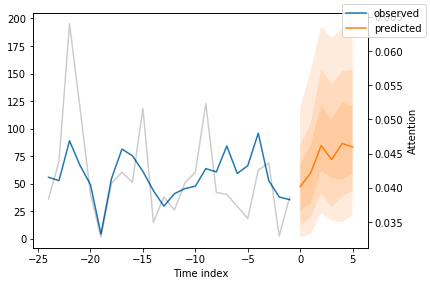

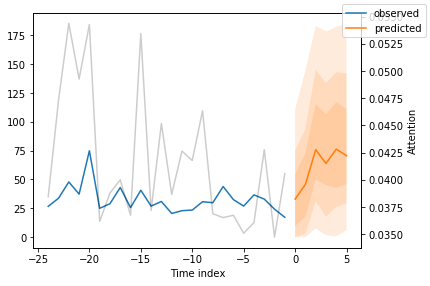

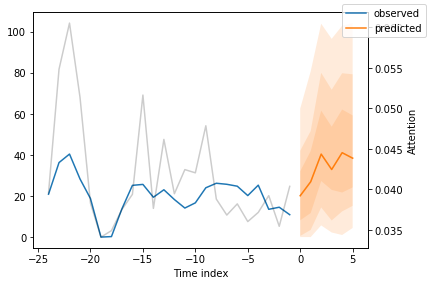

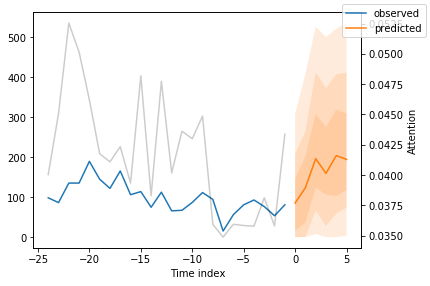

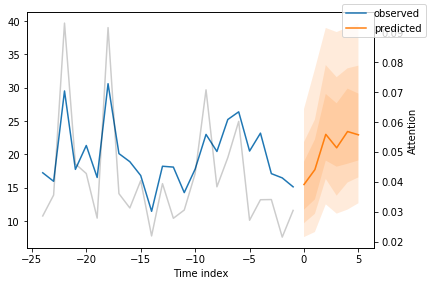

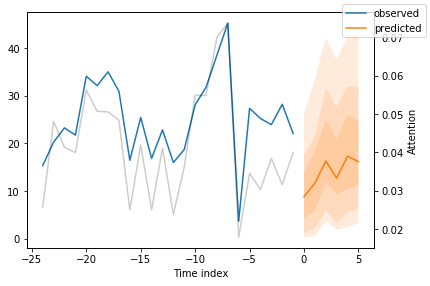

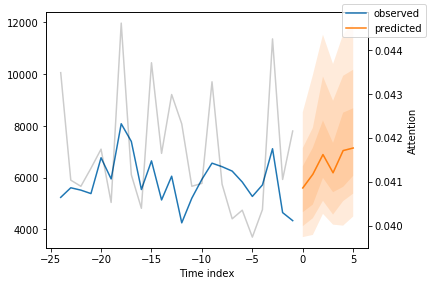

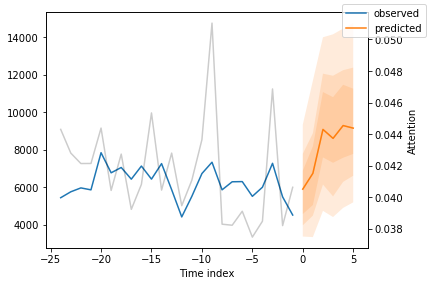

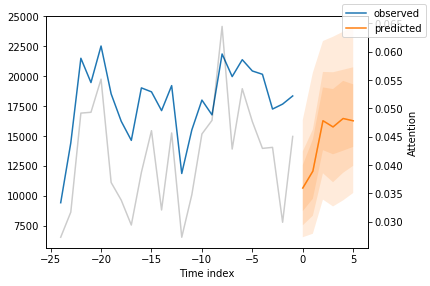

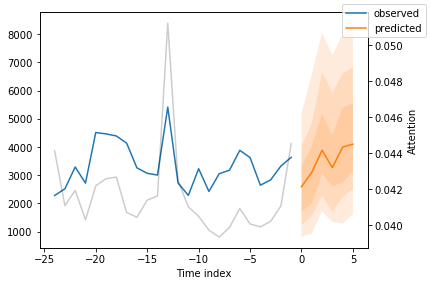

In [21]:
new_raw_predictions, new_x = best_tft.predict(new_prediction_data, mode="raw", return_x=True)

for idx in range(10):  # plot 10 examples
    best_tft.plot_prediction(new_x, new_raw_predictions, idx=idx, show_future_observed=False);

## Interpret model

### Variable importances

{'attention': <Figure size 432x288 with 1 Axes>,
 'static_variables': <Figure size 504x270 with 1 Axes>,
 'encoder_variables': <Figure size 504x378 with 1 Axes>,
 'decoder_variables': <Figure size 504x252 with 1 Axes>}

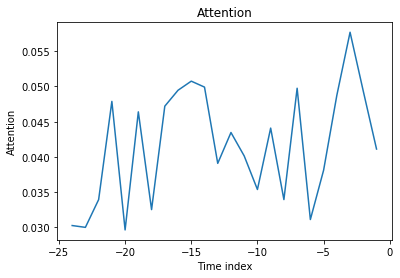

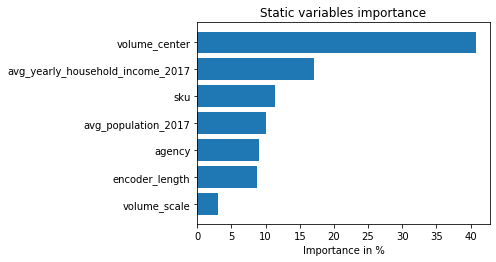

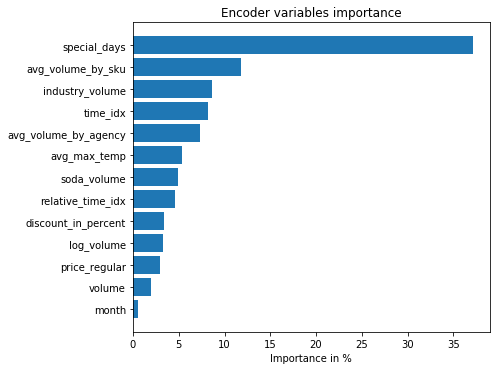

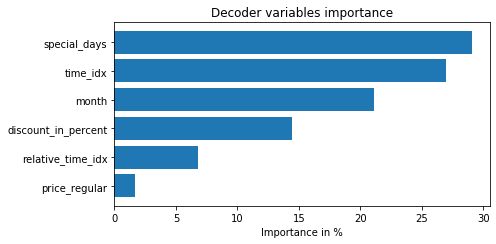

In [22]:
interpretation = best_tft.interpret_output(raw_predictions, reduction="sum")
best_tft.plot_interpretation(interpretation)

Unsurprisingly, the past observed volume features as the top variable in the encoder and price related variables are among the top predictors in the decoder.

The general attention patterns seems to be that more recent observations are more important and older ones. This confirms intuition. The average attention is often not very useful - looking at the attention by example is more insightful because patterns are not averaged out.

### Partial dependency

In [23]:
dependency = best_tft.predict_dependency(
    val_dataloader.dataset, "discount_in_percent", np.linspace(0, 30, 30), show_progress_bar=True, mode="dataframe"
)

Predict:   0%|          | 0/30 [00:00<?, ? batches/s]

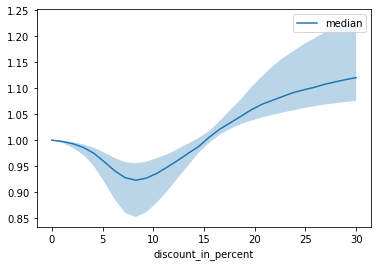

In [24]:
# plotting median and 25% and 75% percentile
agg_dependency = dependency.groupby("discount_in_percent").normalized_prediction.agg(
    median="median", q25=lambda x: x.quantile(0.25), q75=lambda x: x.quantile(0.75)
)
ax = agg_dependency.plot(y="median")
ax.fill_between(agg_dependency.index, agg_dependency.q25, agg_dependency.q75, alpha=0.3);